In [ ]:
!pip install ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 356.2/356.2 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 14.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 20.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 28.4 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=b84b327a50cb44384e2aec533517f03305581e9466b812276837b069bf55ab36
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


**IMPORT REQUIRED LIBRARIES**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import ydata_profiling as profilereport
from statsmodels.stats.outliers_influence import variance_inflation_factor
import scipy.stats as stat
import pylab
from sklearn.model_selection import train_test_split



**IMPORTING THE DATA**

In [ ]:
df= pd.read_csv("https://raw.githubusercontent.com/Harikishan63/Data-Learnings-/refs/heads/main/trainingData%20.csv")
df.head()

,Id,city,age,sex,social_class,primary_business,secondary_business,annual_income,monthly_expenses,old_dependents,...,home_ownership,type_of_house,occupants_count,house_area,sanitary_availability,water_availabity,loan_purpose,loan_tenure,loan_installments,loan_amount
0,1,Dhanbad,22,F,Mochi,Tailoring,Others,36000.0,5000.0,0,...,1.0,R,4,70.0,1.0,0.5,Apparels,12,12,5000.0
1,2,Manjapra,21,F,OBC,Tailoring,none,94000.0,3600.0,1,...,1.0,T1,4,80.0,1.0,0.5,Apparels,12,50,7500.0
2,3,Dhanbad,24,M,Nai,Beauty salon,Others,48000.0,4000.0,0,...,1.0,T1,4,50.0,1.0,0.5,Beauty Salon,12,12,5000.0
3,4,NaN,26,F,OBC,Tailoring,none,7000.0,5000.0,0,...,1.0,T1,5,50.0,1.0,0.5,Apparels,12,50,7500.0
4,5,Nuapada,23,F,OBC,General store,Agriculture,36000.0,3500.0,0,...,1.0,T1,1,112.0,1.0,0.5,Retail Store,12,12,5000.0


In [ ]:
df.describe()

,Id,age,annual_income,monthly_expenses,old_dependents,young_dependents,home_ownership,occupants_count,house_area,sanitary_availability,water_availabity,loan_tenure,loan_installments,loan_amount
count,40000.00000,40000.00000,4.000000e+04,39880.000000,40000.000000,40000.00000,39621.000000,40000.000000,40000.000000,39792.000000,34747.000000,40000.000000,40000.000000,4.000000e+04
mean,20000.50000,55.15990,3.764021e+04,3810.875401,0.044900,1.13710,0.972489,26.641000,552.804750,0.686369,0.753216,12.032225,21.761175,8.412593e+03
std,11547.14972,3830.35566,2.873912e+04,4592.958009,0.222003,1.07384,0.163568,4749.995485,4596.921905,0.464028,0.255337,1.367473,16.682458,1.359694e+04
min,1.00000,2.00000,0.000000e+00,2.000000,0.000000,0.00000,0.000000,0.000000,0.000000,-1.000000,-1.000000,3.000000,0.000000,1.000000e+02
25%,10000.75000,29.00000,1.440000e+04,2500.000000,0.000000,0.00000,1.000000,2.000000,200.000000,0.000000,0.500000,12.000000,12.000000,5.000000e+03
50%,20000.50000,35.00000,3.600000e+04,3500.000000,0.000000,1.00000,1.000000,3.000000,400.000000,1.000000,1.000000,12.000000,12.000000,8.000000e+03
75%,30000.25000,42.00000,5.600000e+04,4000.000000,0.000000,2.00000,1.000000,4.000000,600.000000,1.000000,1.000000,12.000000,50.000000,1.000000e+04
max,40000.00000,766105.00000,1.200000e+06,240000.000000,3.000000,7.00000,1.000000,950000.000000,700000.000000,1.000000,1.000000,84.000000,84.000000,1.343000e+06


In [ ]:
#generate profile report
profilereport.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#calculating missing values
df.isnull().sum()

,0
Id,0
city,1864
age,0
sex,0
social_class,5255
primary_business,26
secondary_business,5241
annual_income,0
monthly_expenses,120
old_dependents,0


**Handling Missing Values**

In [ ]:
#1. City (1,864 missing values):
#We'll use mode  here, which means we'll replace missing values with the most common city. Impute missing values in 'city' with the mode (most frequent value)
mode_city = df['city'].mode()[0]  # Get the mode
df['city'].fillna(mode_city, inplace=True)  # Fill missing values with mode


#2. Social Class (5,255 missing values): For categorical columns like this, we'll add a new category 'Unknown' to represent missing values.#
# Impute missing values in 'social_class' by adding a new category 'Unknown'
df['social_class'].fillna('Unknown', inplace=True)

#3.Secondary Business (5,241 missing values): Similarly, we'll treat missing values in this column by assigning 'None' to those who don't have a secondary business.
# Impute missing values in 'secondary_business' by adding a new category 'None'
df['secondary_business'].fillna('None', inplace=True)

#4. Home Ownership (379 missing values): Since this is a binary column (1 for ownership, 0 for no ownership), we will replace missing values with the most frequent value (mode).
# Impute missing values in 'home_ownership' with the mode
mode_home_ownership = df['home_ownership'].mode()[0]
df['home_ownership'].fillna(mode_home_ownership, inplace=True)

#5.Water Availability (5,253 missing values): Water availability seems to be a numeric or binary feature (values like 0.5). We can fill missing values with the median as it handles skewness better than the mean.#
# Impute missing values in 'water_availabity' with the median
median_water_availabity = df['water_availabity'].median()
df['water_availabity'].fillna(median_water_availabity, inplace=True)

#6. Sanitary Availability (208 missing values):This also seems to be a binary indicator, so we will fill missing values with the mode (the most frequent value).
# Impute missing values in 'sanitary_availability' with the mode
mode_sanitary_availability = df['sanitary_availability'].mode()[0]
df['sanitary_availability'].fillna(mode_sanitary_availability, inplace=True)

#7 Primary Business (26 missing values): Since this is a categorical variable, we can handle it similarly to the previous categorical columns:
# Mode Imputation: Fill the missing values with the most common (mode) primary business.
# Impute missing values in 'primary_business' with the mode
mode_primary_business = df['primary_business'].mode()[0]
df['primary_business'].fillna(mode_primary_business, inplace=True)

#8Monthly Expenses (120 missing values):For continuous variables like this, we should fill missing values with either:
#Median: This is a good option for skewed data, which is often the case with financial data like expenses.
# Impute missing values in 'monthly_expenses' with the median
median_monthly_expenses = df['monthly_expenses'].median()
df['monthly_expenses'].fillna(median_monthly_expenses, inplace=True)

# 9Type of House (694 missing values): This is likely a categorical variable (house type), so we can use:
#Mode Imputation: Replace missing values with the most common house type.

# Impute missing values in 'type_of_house' with the mode
mode_type_of_house = df['type_of_house'].mode()[0]
df['type_of_house'].fillna(mode_type_of_house, inplace=True)

#10Since loan_purpose is also a categorical variable, we can:Mode Imputation: Fill in the missing loan purposes with the most common value
# Impute missing values in 'loan_purpose' with the mode
mode_loan_purpose = df['loan_purpose'].mode()[0]
df['loan_purpose'].fillna(mode_loan_purpose, inplace=True)


<ipython-input-7-be052e57929f>:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['city'].fillna(mode_city, inplace=True)  # Fill missing values with mode
<ipython-input-7-be052e57929f>:9: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value,

In [ ]:
df2= profilereport.ProfileReport(df)

In [ ]:
df2

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

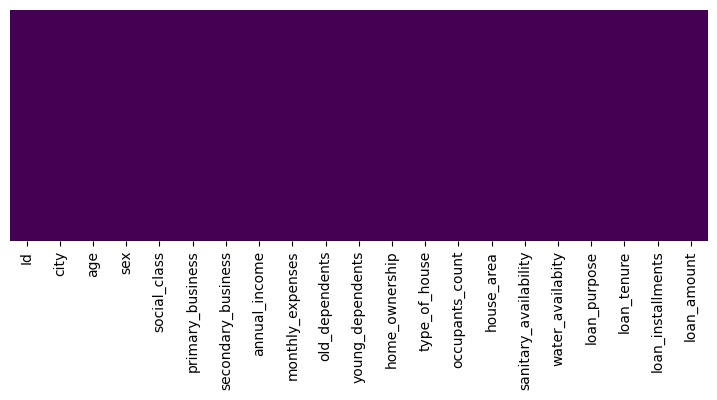

In [ ]:
df.isnull().sum()
plt.figure(figsize=(9,3))
sns.heatmap(df.isnull(), yticklabels=False, cbar=False, cmap='viridis');


***Personal Data***

In [ ]:
personal_features = ["city","age","sex","social_class"]
personal_data = pd.DataFrame(df,columns=personal_features)
personal_data.head(10)

,city,age,sex,social_class
0,Dhanbad,22,F,Mochi
1,Manjapra,21,F,OBC
2,Dhanbad,24,M,Nai
3,Pusad,26,F,OBC
4,Nuapada,23,F,OBC
5,Nuapada,23,F,OBC
6,Dhanbad,22,F,Muchi
7,Pusad,28,F,OBC
8,Dhanbad,38,F,Muchi
9,Dhanbad,25,F,Muchi


In [ ]:
personal_data.info()
personal_data.describe().T


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   city          40000 non-null  object
 1   age           40000 non-null  int64 
 2   sex           40000 non-null  object
 3   social_class  40000 non-null  object
dtypes: int64(1), object(3)
memory usage: 1.2+ MB


,count,mean,std,min,25%,50%,75%,max
age,40000.0,55.1599,3830.35566,2.0,29.0,35.0,42.0,766105.0


<ipython-input-13-e386e46ad6c6>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=personal_data, x='sex', palette='Set2');
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 l

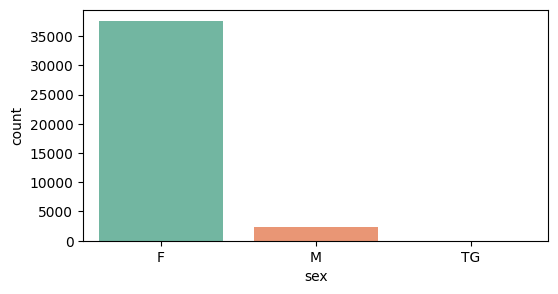

In [ ]:
plt.figure(figsize=(6,3))
sns.countplot(data=personal_data, x='sex', palette='Set2');

***Financial Details***

In [ ]:
financial_features = ["primary_business", "secondary_business", "annual_income", "monthly_expenses", "old_dependents", "young_dependents"]
financial_data = pd.DataFrame(df, columns=financial_features)
financial_data.head(10)

,primary_business,secondary_business,annual_income,monthly_expenses,old_dependents,young_dependents
0,Tailoring,Others,36000.0,5000.0,0,2
1,Tailoring,none,94000.0,3600.0,1,1
2,Beauty salon,Others,48000.0,4000.0,0,2
3,Tailoring,none,7000.0,5000.0,0,2
4,General store,Agriculture,36000.0,3500.0,0,0
5,General store,none,36000.0,3500.0,0,0
6,Tailoring,Others,36000.0,3000.0,0,1
7,Tailoring,none,7000.0,5000.0,0,2
8,Puffed rice business,Others,36000.0,5000.0,0,2
9,General store,Others,36000.0,5000.0,0,3


In [ ]:
financial_data.info()
financial_data.describe().T


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   primary_business    40000 non-null  object 
 1   secondary_business  40000 non-null  object 
 2   annual_income       40000 non-null  float64
 3   monthly_expenses    40000 non-null  float64
 4   old_dependents      40000 non-null  int64  
 5   young_dependents    40000 non-null  int64  
dtypes: float64(2), int64(2), object(2)
memory usage: 1.8+ MB


,count,mean,std,min,25%,50%,75%,max
annual_income,40000.0,37640.214425,28739.116481,0.0,14400.0,36000.0,56000.0,1200000.0
monthly_expenses,40000.0,3809.942775,4586.094740,2.0,2600.0,3500.0,4000.0,240000.0
old_dependents,40000.0,0.044900,0.222003,0.0,0.0,0.0,0.0,3.0
young_dependents,40000.0,1.137100,1.073840,0.0,0.0,1.0,2.0,7.0


Count of different categories in - ["secondary_business, old_dependents, and young_dependents"]: 



<ipython-input-16-c9fc21bf086f>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=financial_data, x=all_cols[i], ax=ax, palette='Set2')
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with

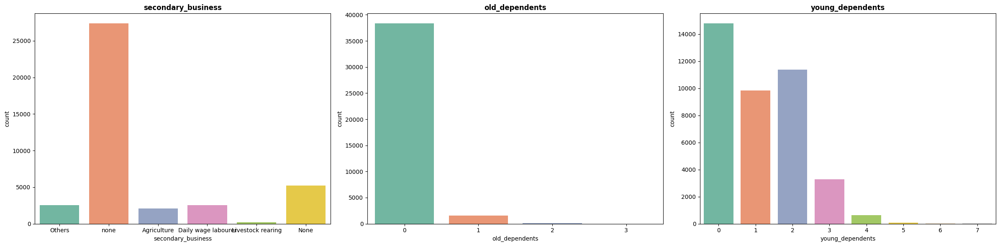

In [ ]:
print('Count of different categories in - ["secondary_business, old_dependents, and young_dependents"]: \n')
fig, axis = plt.subplots(1,3, figsize=(24,6))

all_cols = ["secondary_business", "old_dependents", "young_dependents"]
for i, ax in enumerate(axis.flatten()):
    if i < len(all_cols):
        sns.countplot(data=financial_data, x=all_cols[i], ax=ax, palette='Set2')
        ax.set_title(all_cols[i], fontsize=12, fontweight='bold')
plt.tight_layout()
plt.show()

***Housing Data***

In [ ]:
house_features = ["home_ownership", "type_of_house", "occupants_count", "house_area", "sanitary_availability", "water_availabity"]
house_data = pd.DataFrame(df, columns=house_features)
house_data.head(10)

,home_ownership,type_of_house,occupants_count,house_area,sanitary_availability,water_availabity
0,1.0,R,4,70.0,1.0,0.5
1,1.0,T1,4,80.0,1.0,0.5
2,1.0,T1,4,50.0,1.0,0.5
3,1.0,T1,5,50.0,1.0,0.5
4,1.0,T1,1,112.0,1.0,0.5
5,1.0,T1,1,112.0,1.0,0.5
6,1.0,T1,3,60.0,1.0,0.5
7,1.0,T1,5,40.0,1.0,0.5
8,1.0,T1,5,50.0,1.0,0.5
9,1.0,R,5,50.0,1.0,0.5


In [ ]:
house_data.info()
house_data.describe().T


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 6 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   home_ownership         40000 non-null  float64
 1   type_of_house          40000 non-null  object 
 2   occupants_count        40000 non-null  int64  
 3   house_area             40000 non-null  float64
 4   sanitary_availability  40000 non-null  float64
 5   water_availabity       40000 non-null  float64
dtypes: float64(4), int64(1), object(1)
memory usage: 1.8+ MB


,count,mean,std,min,25%,50%,75%,max
home_ownership,40000.0,0.972750,0.162813,0.0,1.0,1.0,1.0,1.0
occupants_count,40000.0,26.641000,4749.995485,0.0,2.0,3.0,4.0,950000.0
house_area,40000.0,552.804750,4596.921905,0.0,200.0,400.0,600.0,700000.0
sanitary_availability,40000.0,0.688000,0.463370,-1.0,0.0,1.0,1.0,1.0
water_availabity,40000.0,0.785625,0.252156,-1.0,0.5,1.0,1.0,1.0


Count of different categories in - ["home_ownership", "type_of_house", "sanitary_availability", "water_availabity"]: 



<ipython-input-19-560357788845>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=house_data, x=all_cols[i], ax=ax, palette='Set2')
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
<ipython-input-19-560357788845>:7: FutureWarning: 

Passing `palette` without assigning `hue` is de

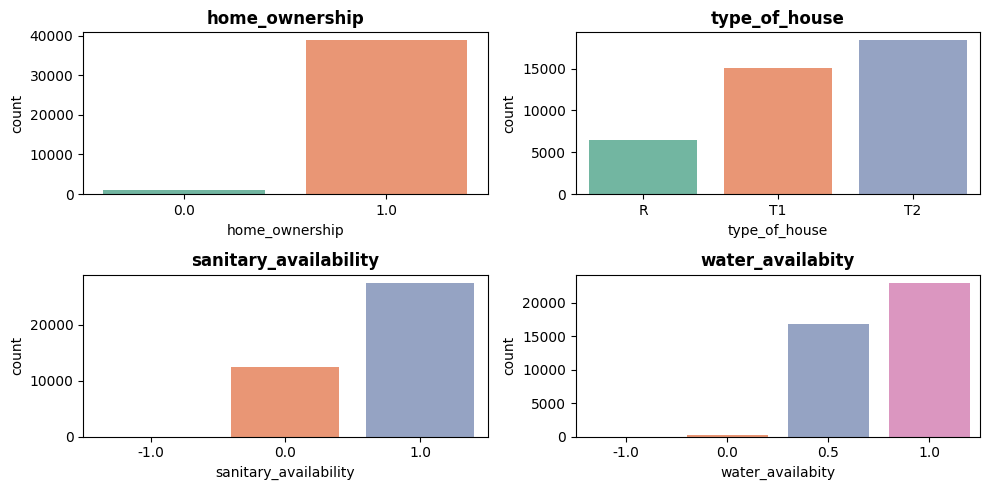

In [ ]:
print('Count of different categories in - ["home_ownership", "type_of_house", "sanitary_availability", "water_availabity"]: \n')
fig, axis = plt.subplots(2,2, figsize=(10,5))

all_cols = ["home_ownership", "type_of_house", "sanitary_availability", "water_availabity"]
for i, ax in enumerate(axis.flatten()):
    if i < len(all_cols):
        sns.countplot(data=house_data, x=all_cols[i], ax=ax, palette='Set2')
        ax.set_title(all_cols[i], fontsize=12, fontweight='bold')
plt.tight_layout()
plt.show()

***Loan Details***

In [ ]:
loan_features = ["loan_purpose","loan_tenure","loan_installments","loan_amount"]
loan_data = pd.DataFrame(df, columns=loan_features)
loan_data.head(10)


,loan_purpose,loan_tenure,loan_installments,loan_amount
0,Apparels,12,12,5000.0
1,Apparels,12,50,7500.0
2,Beauty Salon,12,12,5000.0
3,Apparels,12,50,7500.0
4,Retail Store,12,12,5000.0
5,Retail Store,12,12,5000.0
6,Apparels,12,12,5000.0
7,Apparels,12,50,7500.0
8,Eateries,12,12,5000.0
9,Retail Store,12,12,5000.0


In [ ]:
loan_data.info()
loan_data.describe().T


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 4 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   loan_purpose       40000 non-null  object 
 1   loan_tenure        40000 non-null  int64  
 2   loan_installments  40000 non-null  int64  
 3   loan_amount        40000 non-null  float64
dtypes: float64(1), int64(2), object(1)
memory usage: 1.2+ MB


,count,mean,std,min,25%,50%,75%,max
loan_tenure,40000.0,12.032225,1.367473,3.0,12.0,12.0,12.0,84.0
loan_installments,40000.0,21.761175,16.682458,0.0,12.0,12.0,50.0,84.0
loan_amount,40000.0,8412.592500,13596.938096,100.0,5000.0,8000.0,10000.0,1343000.0


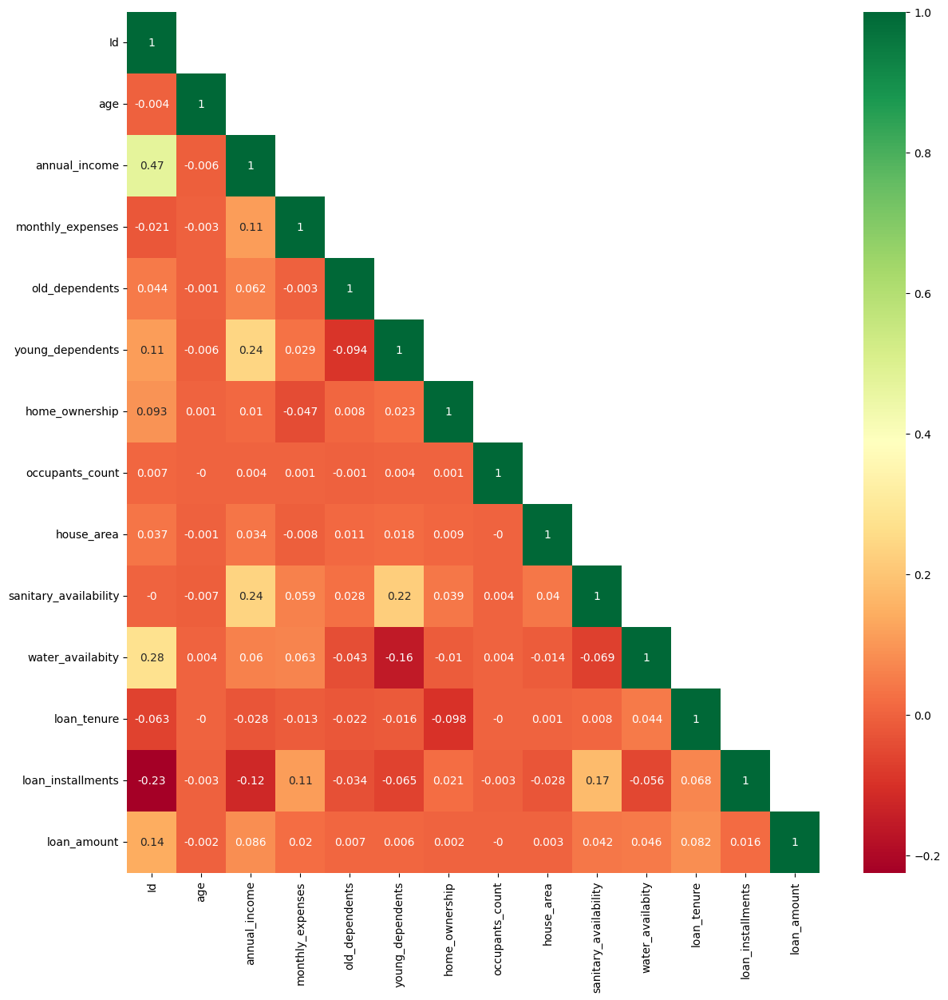

In [ ]:
plt.figure(figsize=(14,14))

corr_matrix = df.corr(numeric_only=True)
mask = np.tril(np.ones_like(corr_matrix, dtype=bool))
lower_triangle = corr_matrix.where(mask)

sns.heatmap(round(lower_triangle, 3), annot=True, cmap='RdYlGn');

Strong positive correlations:

Id and annual_income (0.47), which may indicate that
income increases with higher IDs (perhaps due to sorting).
water_availabity and Id (0.43), which suggests a notable correlation between water availability and the ID (which could be an unintended artifact).

Moderate correlations:

1.annual_income and young_dependents (0.24), indicating a moderate positive relationship between income and the number of young dependents.
sanitary_availability and young_dependents (0.23), suggesting households with more young dependents have better sanitary availability.

***Checking for Multicollinearity***

In [ ]:
# Select only the numerical columns
numerical_columns = df.select_dtypes(include=['float64', 'int64'])

# Create a DataFrame to store VIF values
vif_data = pd.DataFrame()
vif_data['Feature'] = numerical_columns.columns

# Calculate VIF for each feature
vif_data['VIF'] = [variance_inflation_factor(numerical_columns.values, i) for i in range(numerical_columns.shape[1])]

# Display VIF values
print(vif_data)

                  Feature        VIF
0                      Id   6.066833
1                     age   1.000338
2           annual_income   3.977392
3        monthly_expenses   1.756590
4          old_dependents   1.065653
5        young_dependents   2.435711
6          home_ownership  25.480176
7         occupants_count   1.000119
8              house_area   1.018945
9   sanitary_availability   3.721105
10       water_availabity  11.716795
11            loan_tenure  30.664078
12      loan_installments   3.021272
13            loan_amount   1.425978


Features with High VIF:
Home Ownership (VIF = 25.48): Very high multicollinearity.

Water Availability (VIF = 11.72): High multicollinearity.

Loan Tenure (VIF = 30.66): Extremely high multicollinearity.

Id (VIF = 6.06): Moderate to high multicollinearity.





**Droping Feature with High VIF**

In [ ]:
df3 = df.drop(columns=[ 'home_ownership', 'water_availabity','Id'])


In [ ]:
df3.head()

,city,age,sex,social_class,primary_business,secondary_business,annual_income,monthly_expenses,old_dependents,young_dependents,type_of_house,occupants_count,house_area,sanitary_availability,loan_purpose,loan_tenure,loan_installments,loan_amount
0,Dhanbad,22,F,Mochi,Tailoring,Others,36000.0,5000.0,0,2,R,4,70.0,1.0,Apparels,12,12,5000.0
1,Manjapra,21,F,OBC,Tailoring,none,94000.0,3600.0,1,1,T1,4,80.0,1.0,Apparels,12,50,7500.0
2,Dhanbad,24,M,Nai,Beauty salon,Others,48000.0,4000.0,0,2,T1,4,50.0,1.0,Beauty Salon,12,12,5000.0
3,Pusad,26,F,OBC,Tailoring,none,7000.0,5000.0,0,2,T1,5,50.0,1.0,Apparels,12,50,7500.0
4,Nuapada,23,F,OBC,General store,Agriculture,36000.0,3500.0,0,0,T1,1,112.0,1.0,Retail Store,12,12,5000.0


In [ ]:
all_features =list(df.columns)
print('>>>all Features> \n',all_features)

>>>all Features> 
 ['Id', 'city', 'age', 'sex', 'social_class', 'primary_business', 'secondary_business', 'annual_income', 'monthly_expenses', 'old_dependents', 'young_dependents', 'home_ownership', 'type_of_house', 'occupants_count', 'house_area', 'sanitary_availability', 'water_availabity', 'loan_purpose', 'loan_tenure', 'loan_installments', 'loan_amount']


In [ ]:
dependent_feature = ['loan_amount']
independent_features = [feature for feature in all_features if feature not in dependent_feature]

print('>>> All independent_features: \n', independent_features)
# Check unique categories in features with less than or equal to 10 unique values
for feature in all_features:
    if len(df[feature].unique()) <= 10:
        print(f'>> Unique categories in {feature}: \n', df[feature].unique(), '\n')

>>> All independent_features: 
 ['Id', 'city', 'age', 'sex', 'social_class', 'primary_business', 'secondary_business', 'annual_income', 'monthly_expenses', 'old_dependents', 'young_dependents', 'home_ownership', 'type_of_house', 'occupants_count', 'house_area', 'sanitary_availability', 'water_availabity', 'loan_purpose', 'loan_tenure', 'loan_installments']
>> Unique categories in sex: 
 ['F' 'M' 'TG'] 

>> Unique categories in secondary_business: 
 ['Others' 'none' 'Agriculture' 'Daily wage labourer' 'Livestock rearing'
 'None'] 

>> Unique categories in old_dependents: 
 [0 1 2 3] 

>> Unique categories in young_dependents: 
 [2 1 0 3 4 5 6 7] 

>> Unique categories in home_ownership: 
 [1. 0.] 

>> Unique categories in type_of_house: 
 ['R' 'T1' 'T2'] 

>> Unique categories in sanitary_availability: 
 [ 1.  0. -1.] 

>> Unique categories in water_availabity: 
 [ 0.5  1.   0.  -1. ] 



In [ ]:
cat_features = [feature for feature in independent_features if df[feature].dtype == 'O'] + ['home_ownership', 'sanitary_availability', 'water_availabity']
num_features = [feature for feature in independent_features if feature not in cat_features + ['Id']]
len(df.columns), (len(cat_features) + len(num_features)) # +1 for Id

(21, 19)

In [ ]:
print('>>> All Categorical features: \n', cat_features)
print('\n>>> All Numerical features: \n', num_features)

>>> All Categorical features: 
 ['city', 'sex', 'social_class', 'primary_business', 'secondary_business', 'type_of_house', 'loan_purpose', 'home_ownership', 'sanitary_availability', 'water_availabity']

>>> All Numerical features: 
 ['age', 'annual_income', 'monthly_expenses', 'old_dependents', 'young_dependents', 'occupants_count', 'house_area', 'loan_tenure', 'loan_installments']


**Defining Age Criteria**

In [ ]:
df_age = df.copy()

# Create bins for age groups
bins = [0, 17, 81, float('inf')]
labels = ['<18', '18-80', '>80']

# Categorize ages into age groups
df_age['age_group'] = pd.cut(df_age['age'], bins=bins, labels=labels)

# Get count of each age group
age_group_counts = df_age['age_group'].value_counts()

print(age_group_counts)


age_group
18-80    39993
>80          5
<18          2
Name: count, dtype: int64


Let's drop age<18 and age>80 line items



In [ ]:
df = df.drop(df[(df['age'] < 18) | (df['age'] > 80)].index)

***Categorical Features***

In [ ]:
len(cat_features)


10

In [ ]:
def get_central_loan_amt(df, cat_columns, centrality):
    central_loan_amt_combined = {}

    for col in cat_columns:
        central_loan_amts = {}

        types = list(df[col].unique())
        for a_type in types:
            if centrality == 'mean':
                central_loan_amt = df[df[col] == a_type]['loan_amount'].mean()
                central_loan_amts[a_type] = central_loan_amt
            elif centrality == 'median':
                central_loan_amt = df[df[col] == a_type]['loan_amount'].median()
                central_loan_amts[a_type] = central_loan_amt
        sorted_items = sorted(central_loan_amts.items())
        central_loan_amts = dict(sorted_items)

        central_loan_amt_combined[col] = central_loan_amts

    return central_loan_amt_combined

In [ ]:
mean_loan_amts = get_central_loan_amt(df, cat_features, centrality='mean')
median_loan_amts = get_central_loan_amt(df, cat_features, centrality='median')


# Visualize and print the variation in the mean loan amount across different categories of several categorical features.

Variation of "mean" loan_amount across each category in a categorical feature: 

	 For city - Max Value: 1000000.0 | Min Value: 2000.0 | Difference = 998000.0
	 For sex - Max Value: 9001.0 | Min Value: 8376.0 | Difference = 625.0
	 For social_class - Max Value: 1343000.0 | Min Value: 3000.0 | Difference = 1340000.0
	 For primary_business - Max Value: 750000.0 | Min Value: 2500.0 | Difference = 747500.0
	 For secondary_business - Max Value: 9117.0 | Min Value: 5325.0 | Difference = 3792.0
	 For type_of_house - Max Value: 9533.0 | Min Value: 8183.0 | Difference = 1350.0
	 For loan_purpose - Max Value: 292400.0 | Min Value: 2500.0 | Difference = 289900.0
	 For home_ownership - Max Value: 8417.0 | Min Value: 8282.0 | Difference = 135.0
	 For sanitary_availability - Max Value: 8793.0 | Min Value: 7574.0 | Difference = 1219.0
	 For water_availabity - Max Value: 9148.0 | Min Value: 7648.0 | Difference = 1500.0


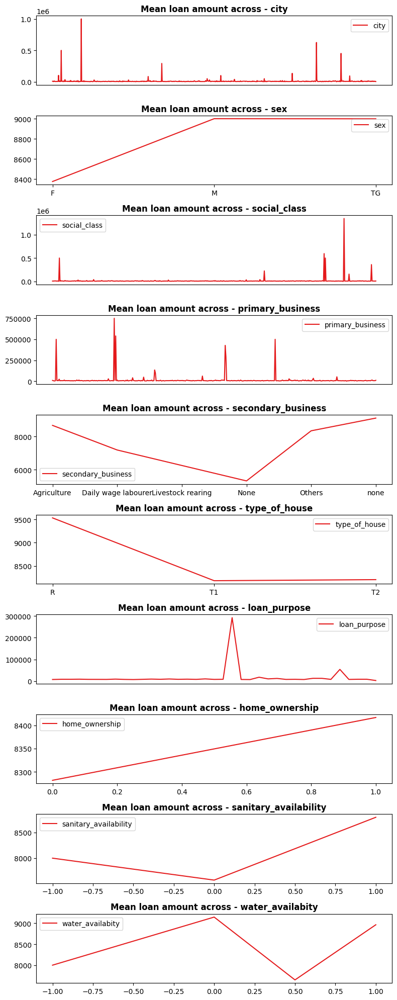

In [ ]:
print('Variation of "mean" loan_amount across each category in a categorical feature: \n')
fig, axis = plt.subplots(10,1, figsize=(8,20))

all_cols = list(mean_loan_amts.keys())
for i, ax in enumerate(axis.flatten()):
    if i < len(mean_loan_amts.keys()):
        mean_price_df = pd.DataFrame.from_dict(mean_loan_amts[all_cols[i]], orient='index', columns=[all_cols[i]])
        sns.lineplot(data=mean_price_df, ax=ax, palette='Set1')
        ax.set_title('Mean loan amount across - ' + all_cols[i], fontsize=12, fontweight='bold')

        # Check number of xticks
        if len(mean_price_df.index) > 10:
            ax.set_xticks([])  # Remove xticks if count of all xticks>10

        max_value, min_value = round(max(mean_price_df[all_cols[i]]), 0), round(min(mean_price_df[all_cols[i]]), 0)
        diff = max_value - min_value
        print(f"\t For {all_cols[i]} - Max Value: {max_value} | Min Value: {min_value} | Difference = {diff}")
plt.tight_layout()
plt.show()

# Calculate and Visualize the median loan amounts instead of the mean






Variation of "median" loan_amount across each category in a categorical feature: 

	 For city - Max Value: 1000000.0 | Min Value: 2000.0 | Difference = 998000.0
	 For sex - Max Value: 10000.0 | Min Value: 8000.0 | Difference = 2000.0
	 For social_class - Max Value: 1343000.0 | Min Value: 3000.0 | Difference = 1340000.0
	 For primary_business - Max Value: 750000.0 | Min Value: 2500.0 | Difference = 747500.0
	 For secondary_business - Max Value: 8000.0 | Min Value: 5000.0 | Difference = 3000.0
	 For type_of_house - Max Value: 8000.0 | Min Value: 8000.0 | Difference = 0.0
	 For loan_purpose - Max Value: 292400.0 | Min Value: 2500.0 | Difference = 289900.0
	 For home_ownership - Max Value: 8000.0 | Min Value: 5000.0 | Difference = 3000.0
	 For sanitary_availability - Max Value: 8000.0 | Min Value: 7500.0 | Difference = 500.0
	 For water_availabity - Max Value: 8000.0 | Min Value: 7500.0 | Difference = 500.0


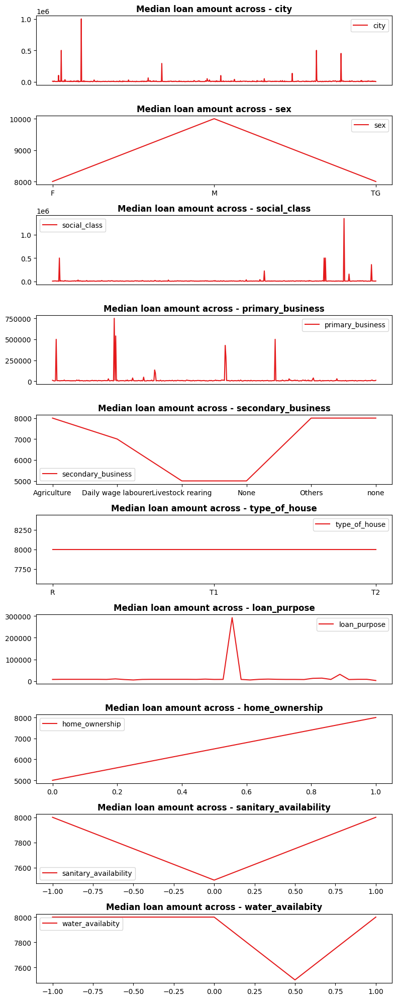

In [ ]:
print('Variation of "median" loan_amount across each category in a categorical feature: \n')
fig, axis = plt.subplots(10,1, figsize=(8,20))

all_cols = list(median_loan_amts.keys())
for i, ax in enumerate(axis.flatten()):
    if i < len(median_loan_amts.keys()):
        median_price_df = pd.DataFrame.from_dict(median_loan_amts[all_cols[i]], orient='index', columns=[all_cols[i]])
        sns.lineplot(data=median_price_df, ax=ax, palette='Set1')
        ax.set_title('Median loan amount across - ' + all_cols[i], fontsize=12, fontweight='bold')
        max_value, min_value = round(max(median_price_df[all_cols[i]]), 0), round(min(median_price_df[all_cols[i]]), 0)

        # Check number of xticks
        if len(median_price_df.index) > 10:
            ax.set_xticks([])  # Remove xticks if count of all xticks>10

        diff = max_value - min_value
        print(f"\t For {all_cols[i]} - Max Value: {max_value} | Min Value: {min_value} | Difference = {diff}")
plt.tight_layout()
plt.show()

***Numerical Features***

In [ ]:
len(num_features)

9

In [ ]:
discreate_num_features, continuous_num_features = [], []

for feature in num_features:
        discreate_num_features.append(feature) if df[feature].nunique() <= 25 else continuous_num_features.append(feature)

In [ ]:
discreate_num_features



['old_dependents',
 'young_dependents',
 'occupants_count',
 'loan_tenure',
 'loan_installments']

In [ ]:
continuous_num_features

['age', 'annual_income', 'monthly_expenses', 'house_area']

<ipython-input-43-ac7ddde8d202>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(df[continuous_num_features[i]], ax=ax, palette='Set2')
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
<ipython-input-43-ac7ddde8d202>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue`

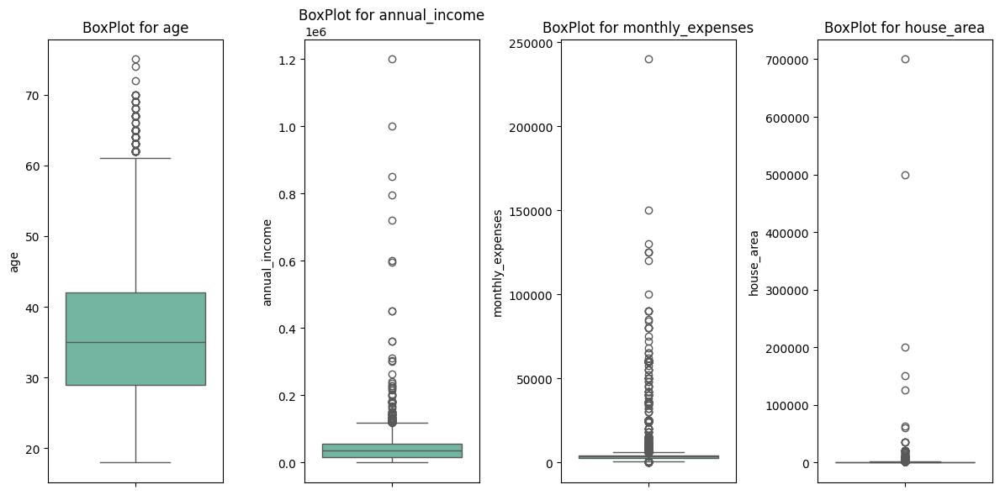

In [ ]:
# Continuous Numerical Variable - Checking Outliers

fig, axis = plt.subplots(1,4, figsize=(12,6))
for i, ax in enumerate(axis.flatten()):
    if i < len(continuous_num_features):
        sns.boxplot(df[continuous_num_features[i]], ax=ax, palette='Set2')
        ax.set_title(f'BoxPlot for {continuous_num_features[i]}')
plt.tight_layout()
plt.show()

In [ ]:
def drop_outliers(df, column_name):
    Q1 = df[column_name].quantile(0.25)
    Q3 = df[column_name].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 3 * IQR
    upper_bound = Q3 + 3 * IQR
    df_filtered = df[(df[column_name] >= lower_bound) & (df[column_name] <= upper_bound)]
    return df_filtered

In [ ]:
len(df)

39993

In [ ]:
for feature in continuous_num_features:
    df = drop_outliers(df, feature)

<ipython-input-47-fe24be361303>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(df[continuous_num_features[i]], ax=ax, palette='Set3')
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)
<ipython-input-47-fe24be361303>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue`

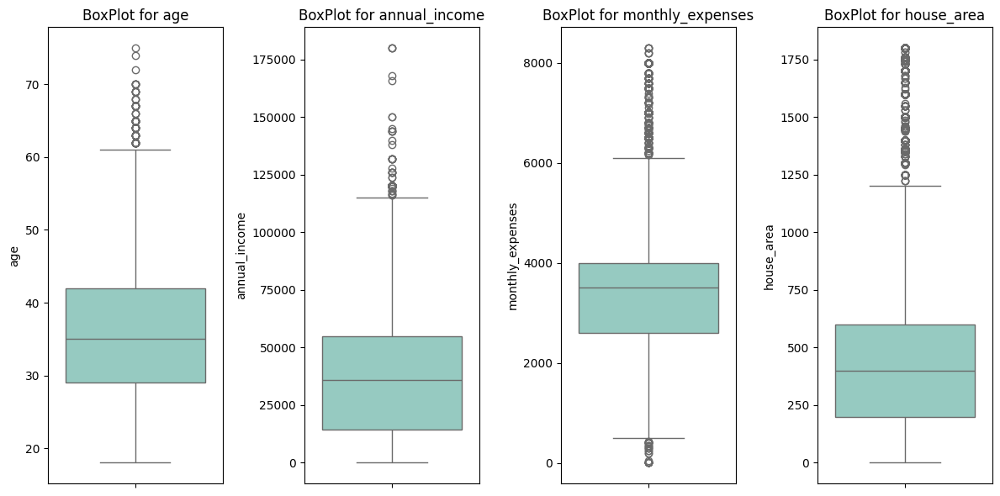

In [ ]:
# Continuous Numerical Variable - Checking Outliers

fig, axis = plt.subplots(1,4, figsize=(12,6))
for i, ax in enumerate(axis.flatten()):
    if i < len(continuous_num_features):
        sns.boxplot(df[continuous_num_features[i]], ax=ax, palette='Set3')
        ax.set_title(f'BoxPlot for {continuous_num_features[i]}')
plt.tight_layout()
plt.show()

In [ ]:
def plot_data(df, feature):
    plt.figure(figsize = (10,4))

    plt.subplot(1,2,1)
    sns.histplot(df[feature], bins=50, kde=True, palette='Set1')
    plt.title(f'Histogram of feature - {feature}')

    plt.subplot(1,2,2)
    stat.probplot(df[feature], dist='norm', plot=pylab)

    plt.tight_layout()
    plt.show()

<ipython-input-48-4b6d8600fd35>:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[feature], bins=50, kde=True, palette='Set1')


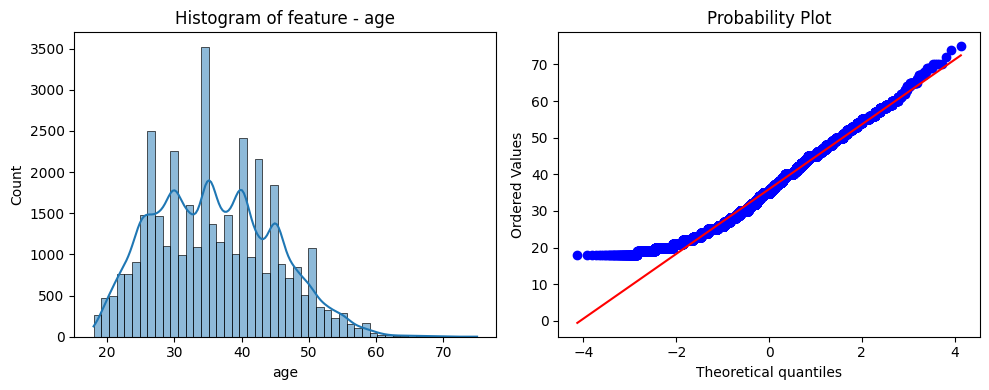

<ipython-input-48-4b6d8600fd35>:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[feature], bins=50, kde=True, palette='Set1')


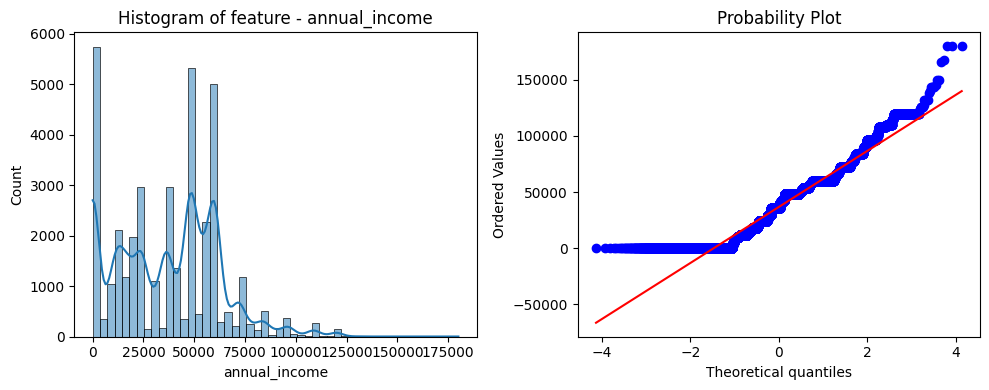

<ipython-input-48-4b6d8600fd35>:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[feature], bins=50, kde=True, palette='Set1')


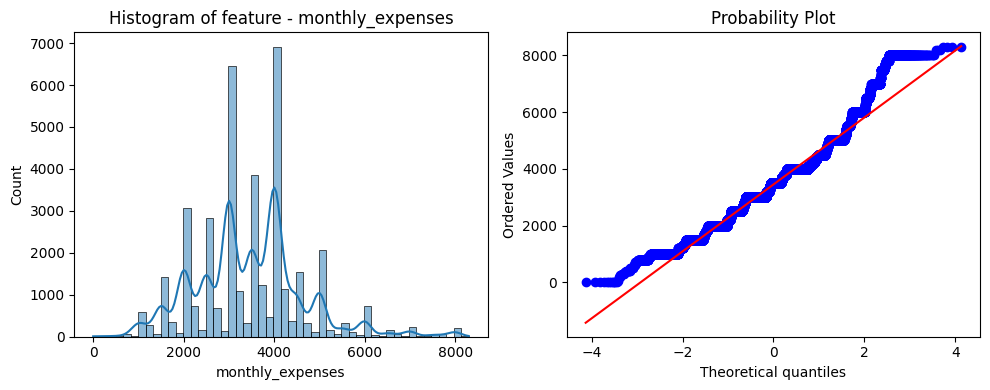

<ipython-input-48-4b6d8600fd35>:5: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(df[feature], bins=50, kde=True, palette='Set1')


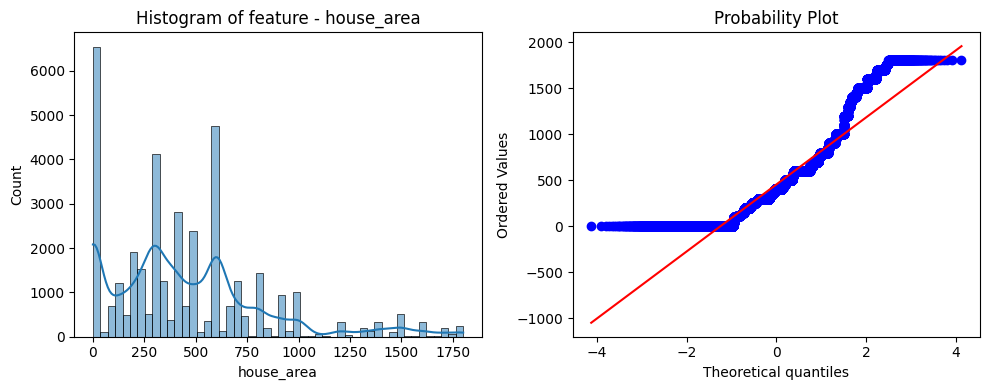

In [ ]:
# Continuous Numerical Variables - Checking Normality

skipped_features = []
for feature in continuous_num_features:
    plot_data(df, feature=feature)

# Data Preprocessing for Model Building

In [ ]:
selected_features = [
    "Id", "age", "sex", "annual_income", "monthly_expenses", "old_dependents", "young_dependents",  "home_ownership", "type_of_house",
    "occupants_count", "house_area", "loan_tenure", "loan_installments"
]
print('Count of selected_features:', len(selected_features))


Count of selected_features: 13


In [ ]:
dropped_features = [feat for feat in all_cols if feat not in selected_features]

print('All dropped features:', dropped_features)
print('Count:', len(dropped_features))

All dropped features: ['city', 'social_class', 'primary_business', 'secondary_business', 'loan_purpose', 'sanitary_availability', 'water_availabity']
Count: 7


In [ ]:
selected_num_features = [feature for feature in num_features if feature in selected_features]

print('Selected num_features: \n', selected_num_features)
print('Count:', len(selected_num_features))

selected_cat_features = [feature for feature in cat_features if feature in selected_features]

print('Selected cat_features:', selected_cat_features)
print('Count:', len(selected_cat_features))

Selected num_features: 
 ['age', 'annual_income', 'monthly_expenses', 'old_dependents', 'young_dependents', 'occupants_count', 'house_area', 'loan_tenure', 'loan_installments']
Count: 9
Selected cat_features: ['sex', 'type_of_house', 'home_ownership']
Count: 3


In [ ]:
df_selected_features = df[selected_features]

df_selected_features.head()


,Id,age,sex,annual_income,monthly_expenses,old_dependents,young_dependents,home_ownership,type_of_house,occupants_count,house_area,loan_tenure,loan_installments
0,1,22,F,36000.0,5000.0,0,2,1.0,R,4,70.0,12,12
1,2,21,F,94000.0,3600.0,1,1,1.0,T1,4,80.0,12,50
2,3,24,M,48000.0,4000.0,0,2,1.0,T1,4,50.0,12,12
3,4,26,F,7000.0,5000.0,0,2,1.0,T1,5,50.0,12,50
4,5,23,F,36000.0,3500.0,0,0,1.0,T1,1,112.0,12,12


In [ ]:
X, y = df_selected_features.drop('Id', axis=1), df['loan_amount']
X.head()

,age,sex,annual_income,monthly_expenses,old_dependents,young_dependents,home_ownership,type_of_house,occupants_count,house_area,loan_tenure,loan_installments
0,22,F,36000.0,5000.0,0,2,1.0,R,4,70.0,12,12
1,21,F,94000.0,3600.0,1,1,1.0,T1,4,80.0,12,50
2,24,M,48000.0,4000.0,0,2,1.0,T1,4,50.0,12,12
3,26,F,7000.0,5000.0,0,2,1.0,T1,5,50.0,12,50
4,23,F,36000.0,3500.0,0,0,1.0,T1,1,112.0,12,12


In [ ]:
y.head()

,loan_amount
0,5000.0
1,7500.0
2,5000.0
3,7500.0
4,5000.0


# Applying Train-Test Split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)


In [ ]:
X_train.head()

,age,sex,annual_income,monthly_expenses,old_dependents,young_dependents,home_ownership,type_of_house,occupants_count,house_area,loan_tenure,loan_installments
3602,47,F,12000.0,3600.0,0,0,1.0,T2,3,350.0,12,12
6897,20,F,12000.0,3000.0,0,1,1.0,T2,3,320.0,12,12
20431,43,F,14400.0,5000.0,0,0,1.0,R,4,700.0,12,50
8859,40,F,0.0,5200.0,0,0,1.0,T1,0,0.0,12,50
38758,34,F,60000.0,3000.0,0,0,1.0,R,2,600.0,12,12


In [ ]:
from sklearn.preprocessing import OneHotEncoder, RobustScaler
from sklearn.compose import ColumnTransformer

In [ ]:
num_transformer = RobustScaler()
cat_transformer = OneHotEncoder(drop='first')

In [ ]:
preprocessor = ColumnTransformer(
    [
        ("OneHotEncoder", cat_transformer, selected_cat_features),
        ("RobustScaler", num_transformer, selected_num_features),
    ]
)